In [ ]:
# Ташкент

# Бектимирский_район (2447560) 
# Сергелийский_район (2447546)
# Шайхантахурский_район (2439529)
# Юнусабадский_район (2448072)
# Мирабадский_район (2447634)
# Алмазарский_район (2441651)
# Яшнабадский_район (1751444)
# Яккасарайский_район (2443769)
# Мирзо-Улугбекский_район (5620904)
# Учтепинский_район (2434059)
# Чиланзарский_район (2441810)
# Янгихаётский_район (12030887)




In [1]:
import os.path
import shapely.wkb as wkblib

import numpy as np
import shapely.geometry

from sklearn import tree
import graphviz
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn import metrics
from sklearn.model_selection import cross_val_predict
from sklearn import preprocessing
import jenkspy
from sklearn.metrics import PrecisionRecallDisplay
import osmnx as ox
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

from iduedu import get_boundary

/Users/sashamorozov/Documents/Code/classifier_model_OSM/buildings_classification/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Helping 

In [33]:
local_crs = 32642

In [ ]:
tashkent_districts = {
    'Бектимирский': '2447560',
    'Сергелийский': '2447546',
    'Шайхантахурский': '2439529',
    'Юнусабадский': '2448072',
    'Мирабадский': '2447634',
    'Алмазарский': '2441651',
    'Яшнабадский': '1751444',
    'Яккасарайский': '2443769',
    'Мирзо-Улугбекский': '5620904',
    'Учтепинский': '2434059',
    'Чиланзарский': '2441810',
    'Янгихаётский': '12030887'
}

district_gdfs = {}

for district_name, osm_id in tashkent_districts.items():
    try:
        gdf = ox.geocode_to_gdf(f'R{osm_id}', by_osmid=True)
        district_gdfs[district_name] = gdf
        print(f"Успешно получен полигон района: {district_name}")
    except Exception as e:
        print(f"Ошибка при получении полигона района {district_name}: {e}")


Успешно получен полигон района: Бектимирский
Успешно получен полигон района: Сергелийский
Успешно получен полигон района: Шайхантахурский
Успешно получен полигон района: Юнусабадский
Успешно получен полигон района: Мирабадский
Успешно получен полигон района: Алмазарский
Успешно получен полигон района: Яшнабадский
Успешно получен полигон района: Яккасарайский
Успешно получен полигон района: Мирзо-Улугбекский
Успешно получен полигон района: Учтепинский
Успешно получен полигон района: Чиланзарский
Успешно получен полигон района: Янгихаётский


In [ ]:
tashkent_full = pd.concat(district_gdfs.values(), ignore_index=True)

In [2184]:
tashkent_full.explore()

In [23]:
united_polygon = tashkent_full.unary_union

/var/folders/zx/byb3bcds50s1lwbdr2mwq18r0000gn/T/ipykernel_2882/2662507724.py:1: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  united_polygon = tashkent_full.unary_union


In [25]:
holes = []
if hasattr(united_polygon, 'interiors'):
    # Для одного полигона
    holes = list(united_polygon.interiors)
elif hasattr(united_polygon, 'geoms'):
    # Для мультиполигона
    for polygon in united_polygon.geoms:
        if hasattr(polygon, 'interiors'):
            holes.extend(list(polygon.interiors))


In [ ]:
holes_gdf = gpd.GeoDataFrame(geometry=[shapely.geometry.Polygon(hole) for hole in holes], crs=tashkent_full.crs)

In [43]:
holes_gdf.to_crs(4326, inplace = True)

/var/folders/zx/byb3bcds50s1lwbdr2mwq18r0000gn/T/ipykernel_2882/3023073541.py:1: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  holes_gdf.unary_union


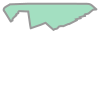

In [44]:
holes_gdf.unary_union

### Buildings

In [2019]:
bounds = get_boundary(osm_id=12030887) 
# bounds = holes_gdf.unary_union

In [2020]:
building_tag = {'building': True}

In [2021]:
gdf_buildings = ox.features_from_polygon(bounds, building_tag)

In [2022]:
gdf_buildings.reset_index(inplace=True)

In [2023]:
gdf_buildings['all_tags'] = gdf_buildings.apply(
    lambda x: {col: x[col] for col in gdf_buildings.columns 
              if col not in ['geometry', 'osmid', 'element', 'id', 'index'] 
              and pd.notnull(x[col])}, 
    axis=1
)
gdf_buildings['all_tag_keys'] = gdf_buildings['all_tags'].apply(lambda x: list(x.keys()))
gdf_buildings['building'] = gdf_buildings['building'].fillna('')

In [2024]:
gdf_buildings = gdf_buildings[['id', 'building', 'geometry', 
                      'all_tag_keys', 'all_tags']]

In [2025]:
gdf_buildings = gdf_buildings[gdf_buildings.geometry.geom_type != 'Point']
gdf_buildings.reset_index(drop=True, inplace=True)

In [2026]:
gdf_buildings

,id,building,geometry,all_tag_keys,all_tags
0,1425721,school,"POLYGON ((69.20964 41.19794, 69.20952 41.1981,...","[building, type]","{'building': 'school', 'type': 'multipolygon'}"
1,1521832,yes,"POLYGON ((69.21791 41.19832, 69.21787 41.1983,...","[building, addr:place, building:levels, type]","{'building': 'yes', 'addr:place': 'Birodarlik ..."
2,1861294,school,"POLYGON ((69.19074 41.23573, 69.19054 41.23589...","[building, addr:housenumber, type]","{'building': 'school', 'addr:housenumber': '26..."
3,2145523,school,"POLYGON ((69.21176 41.19475, 69.21187 41.19459...","[building, building:levels, type]","{'building': 'school', 'building:levels': '3',..."
4,2145524,yes,"POLYGON ((69.20913 41.19906, 69.20903 41.19902...","[building, addr:place, type]","{'building': 'yes', 'addr:place': 'Sputnik 16 ..."
...,...,...,...,...,...
9069,1382084342,yes,"POLYGON ((69.22578 41.19972, 69.22599 41.19981...","[building, building:levels]","{'building': 'yes', 'building:levels': '1'}"
9070,1382084343,yes,"POLYGON ((69.22534 41.20078, 69.22573 41.20093...","[building, addr:place]","{'building': 'yes', 'addr:place': 'Birodarlik ..."
9071,1382084344,yes,"POLYGON ((69.22476 41.20107, 69.22456 41.20099...",[building],{'building': 'yes'}
9072,1382084345,yes,"POLYGON ((69.22553 41.20133, 69.225 41.2011, 6...",[building],{'building': 'yes'}


### Landuse 

In [2027]:
landuse_tag = {'landuse': True}

In [2028]:
gdf_landuse = ox.features_from_polygon(bounds, landuse_tag)

In [2029]:
gdf_landuse.reset_index(inplace=True)
gdf_landuse

,element,id,geometry,abandoned:aeroway,abandoned:icao,barrier,ele,landuse,name,name:en,...,short_name,name:uz,emergency,healthcare,operator,construction,office,opening_date,type,opening_hours
0,relation,1554805,"POLYGON ((69.24087 41.17188, 69.24073 41.17188...",NaN,NaN,NaN,NaN,industrial,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,multipolygon,NaN
1,relation,1661020,"POLYGON ((69.21161 41.20707, 69.21199 41.20722...",NaN,NaN,NaN,395,residential,Сергели 1 массив,Sergeli-1,...,NaN,Sergeli-1,NaN,NaN,NaN,NaN,NaN,NaN,multipolygon,NaN
2,relation,1866492,"POLYGON ((69.21778 41.20413, 69.21798 41.20421...",NaN,NaN,NaN,NaN,residential,Yo‘ldosh (Sputnik) 2 daxasi,Yuldosh (Sputnik) 2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,multipolygon,NaN
3,relation,1866493,"POLYGON ((69.21548 41.19518, 69.21699 41.19578...",NaN,NaN,NaN,NaN,residential,Yo‘ldosh (Sputnik) 8 daxasi,Yuldosh (Sputnik) 8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,multipolygon,NaN
4,relation,1866494,"POLYGON ((69.21105 41.20135, 69.21336 41.2023,...",NaN,NaN,NaN,NaN,residential,Yo‘ldosh (Sputnik) 1 daxasi,Yuldosh (Sputnik) 1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,multipolygon,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294,way,1362860722,"POLYGON ((69.25551 41.1782, 69.25536 41.17836,...",NaN,NaN,NaN,NaN,industrial,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
295,way,1362860729,"POLYGON ((69.25042 41.17117, 69.25008 41.17007...",NaN,NaN,NaN,NaN,industrial,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
296,way,1362860730,"POLYGON ((69.25115 41.17317, 69.25098 41.17155...",NaN,NaN,NaN,NaN,industrial,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
297,way,1362860754,"POLYGON ((69.25884 41.18586, 69.25858 41.18607...",NaN,NaN,NaN,NaN,grass,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [2030]:
gdf_landuse = gdf_landuse[['landuse', 'geometry']]
gdf_landuse

,landuse,geometry
0,industrial,"POLYGON ((69.24087 41.17188, 69.24073 41.17188..."
1,residential,"POLYGON ((69.21161 41.20707, 69.21199 41.20722..."
2,residential,"POLYGON ((69.21778 41.20413, 69.21798 41.20421..."
3,residential,"POLYGON ((69.21548 41.19518, 69.21699 41.19578..."
4,residential,"POLYGON ((69.21105 41.20135, 69.21336 41.2023,..."
...,...,...
294,industrial,"POLYGON ((69.25551 41.1782, 69.25536 41.17836,..."
295,industrial,"POLYGON ((69.25042 41.17117, 69.25008 41.17007..."
296,industrial,"POLYGON ((69.25115 41.17317, 69.25098 41.17155..."
297,grass,"POLYGON ((69.25884 41.18586, 69.25858 41.18607..."


In [2031]:
gdf_landuse.groupby('landuse').count()

,geometry
landuse,
cemetery,6
commercial,8
construction,12
farmland,73
forest,5
garages,1
grass,33
greenfield,1
industrial,60


In [2032]:
non_res = ['commercial', 'retail','industrial','grass','plant_nursery','quarry','railway','government',\
            'institutional']
gdf_landuse['landuse'] = gdf_landuse['landuse'].apply(\
                                lambda x: 'non_res' if x in non_res else x)

/Users/sashamorozov/Documents/Code/classifier_model_OSM/buildings_classification/.venv/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [2033]:
gdf_landuse.groupby('landuse').count()

,geometry
landuse,
cemetery,6
construction,12
farmland,73
forest,5
garages,1
greenfield,1
meadow,9
military,3
non_res,110


In [2034]:
buildings_land = gdf_buildings.sjoin(gdf_landuse, how="left", predicate='intersects')

In [2035]:
buildings_land.shape

(9226, 7)

In [2036]:
buildings_land.drop_duplicates(subset='id',inplace=True)
buildings_land.shape

(9074, 7)

In [2037]:
buildings_land.rename(columns={'index_right': 'index_landuse'},inplace=True)
buildings_land['landuse'] = \
            buildings_land['landuse'].apply(lambda x: 'no_landuse' if pd.isnull(x) else x)
buildings_land.reset_index(inplace=True, drop=True)

In [2038]:
buildings_land[buildings_land['landuse'] == 'no_landuse'].shape

(165, 7)

In [2039]:
len(buildings_land.index_landuse.unique())

134

In [2040]:
buildings_land.groupby('landuse').count()

,id,building,geometry,all_tag_keys,all_tags,index_landuse
landuse,,,,,,
cemetery,4,4,4,4,4,4
construction,106,106,106,106,106,106
farmland,14,14,14,14,14,14
forest,3,3,3,3,3,3
military,6,6,6,6,6,6
no_landuse,165,165,165,165,165,0
non_res,554,554,554,554,554,554
orchard,1,1,1,1,1,1
residential,8221,8221,8221,8221,8221,8221


In [2041]:
buildings_land.groupby(['landuse','building']).count().head(50)

id  geometry  all_tag_keys  all_tags  \
landuse      building                                                
cemetery     yes               4         4             4         4   
construction commercial        1         1             1         1   
             construction      6         6             6         6   
             industrial        1         1             1         1   
             yes              98        98            98        98   
farmland     yes              14        14            14        14   
forest       yes               3         3             3         3   
military     yes               6         6             6         6   
no_landuse   greenhouse        1         1             1         1   
             industrial        3         3             3         3   
             roof              1         1             1         1   
             school            1         1             1         1   
             train_station     1         1             1         1   
             yes             158       158           158       158   
non_res      construction      2         2             2         2   
             industrial        8         8             8         8   
             roof              2         2             2         2   
             warehouse         1         1             1         1   
             yes             541       541           541       541   
orchard      yes               1         1             1         1   
residential  apartments       46        46            46        46   
             cafe              1         1             1         1   
             college           1         1             1         1   
             construction      3         3             3         3   
             garage            5         5             5         5   
             house            22        22            22        22   
             industrial        3         3             3         3   
             kindergarten      4         4             4         4   
             public            1         1             1         1   
             residential       1         1             1         1   
             roof              1         1             1         1   
             school            9         9             9         9   
             service           1         1             1         1   
             shop              2         2             2         2   
             yes            8121      8121          8121      8121   

                            index_landuse  
landuse      building                      
cemetery     yes                        4  
construction commercial                 1  
             construction               6  
             industrial                 1  
             yes                       98  
farmland     yes                       14  
forest       yes                        3  
military     yes                        6  
no_landuse   greenhouse                 0  
             industrial                 0  
             roof                       0  
             school                     0  
             train_station              0  
             yes                        0  
non_res      construction               2  
             industrial                 8  
             roof                       2  
             warehouse                  1  
             yes                      541  
orchard      yes                        1  
residential  apartments                46  
             cafe                       1  
             college                    1  
             construction               3  
             garage                     5  
             house                     22  
             industrial                 3  
             kindergarten               4  
             public                     1  
             residential                1  
             roof              

In [2042]:
buildings_land['land_building'] = buildings_land.apply(lambda x: \
    x['landuse'] if x['building'] == 'yes' else x['building'], axis=1)

In [2043]:
buildings_land.groupby(['landuse','land_building']).count().head(50)

id  building  geometry  all_tag_keys  all_tags  \
landuse      land_building                                                     
cemetery     cemetery          4         4         4             4         4   
construction commercial        1         1         1             1         1   
             construction    104       104       104           104       104   
             industrial        1         1         1             1         1   
farmland     farmland         14        14        14            14        14   
forest       forest            3         3         3             3         3   
military     military          6         6         6             6         6   
no_landuse   greenhouse        1         1         1             1         1   
             industrial        3         3         3             3         3   
             no_landuse      158       158       158           158       158   
             roof              1         1         1             1         1   
             school            1         1         1             1         1   
             train_station     1         1         1             1         1   
non_res      construction      2         2         2             2         2   
             industrial        8         8         8             8         8   
             non_res         541       541       541           541       541   
             roof              2         2         2             2         2   
             warehouse         1         1         1             1         1   
orchard      orchard           1         1         1             1         1   
residential  apartments       46        46        46            46        46   
             cafe              1         1         1             1         1   
             college           1         1         1             1         1   
             construction      3         3         3             3         3   
             garage            5         5         5             5         5   
             house            22        22        22            22        22   
             industrial        3         3         3             3         3   
             kindergarten      4         4         4             4         4   
             public            1         1         1             1         1   
             residential    8122      8122      8122          8122      8122   
             roof              1         1         1             1         1   
             school            9         9         9             9         9   
             service           1         1         1             1         1   
             shop              2         2         2             2         2   

                            index_landuse  
landuse      land_building                 
cemetery     cemetery                   4  
construction commercial                 1  
             construction             104  
             industrial                 1  
farmland     farmland                  14  
forest       forest                     3  
military     military                   6  
no_landuse   greenhouse                 0  
             industrial                 0  
             no_landuse                 0  
             roof                       0  
             school                     0  
             train_station              0  
non_res      construction               2  
             industrial                 8  
             non_res                  541  
             roof                       2  
             warehouse                  1  
orchard      orchard                    1  
residential  apartments                46  
             cafe                       1  
             college                    1  
             construction               3  
             garage                     5  
             house                     22  
             industrial                 3

In [2044]:
buildings_land.groupby(['landuse','land_building']).count().tail(50)

id  building  geometry  all_tag_keys  all_tags  \
landuse      land_building                                                     
cemetery     cemetery          4         4         4             4         4   
construction commercial        1         1         1             1         1   
             construction    104       104       104           104       104   
             industrial        1         1         1             1         1   
farmland     farmland         14        14        14            14        14   
forest       forest            3         3         3             3         3   
military     military          6         6         6             6         6   
no_landuse   greenhouse        1         1         1             1         1   
             industrial        3         3         3             3         3   
             no_landuse      158       158       158           158       158   
             roof              1         1         1             1         1   
             school            1         1         1             1         1   
             train_station     1         1         1             1         1   
non_res      construction      2         2         2             2         2   
             industrial        8         8         8             8         8   
             non_res         541       541       541           541       541   
             roof              2         2         2             2         2   
             warehouse         1         1         1             1         1   
orchard      orchard           1         1         1             1         1   
residential  apartments       46        46        46            46        46   
             cafe              1         1         1             1         1   
             college           1         1         1             1         1   
             construction      3         3         3             3         3   
             garage            5         5         5             5         5   
             house            22        22        22            22        22   
             industrial        3         3         3             3         3   
             kindergarten      4         4         4             4         4   
             public            1         1         1             1         1   
             residential    8122      8122      8122          8122      8122   
             roof              1         1         1             1         1   
             school            9         9         9             9         9   
             service           1         1         1             1         1   
             shop              2         2         2             2         2   

                            index_landuse  
landuse      land_building                 
cemetery     cemetery                   4  
construction commercial                 1  
             construction             104  
             industrial                 1  
farmland     farmland                  14  
forest       forest                     3  
military     military                   6  
no_landuse   greenhouse                 0  
             industrial                 0  
             no_landuse                 0  
             roof                       0  
             school                     0  
             train_station              0  
non_res      construction               2  
             industrial                 8  
             non_res                  541  
             roof                       2  
             warehouse                  1  
orchard      orchard                    1  
residential  apartments                46  
             cafe                       1  
             college                    1  
             construction               3  
             garage                     5  
             house                     22  
             industrial                 3

In [2045]:
def enrich_buildings(buildings_land,tags_list):
    for tag_val in tags_list:
        buildings_land['land_building'] = buildings_land.apply(lambda x: \
            tag_val if x['landuse'] == tag_val else x['land_building'], axis=1)

    return buildings_land

In [2046]:
tags_list = ['residential','commercial','religious','recreation_ground','cemetery',\
            'construction','farmland','farmyard','forest','military']
buildings_land = enrich_buildings(buildings_land,tags_list)

In [2047]:
buildings_land.groupby(['landuse','land_building']).count().head(50)

id  building  geometry  all_tag_keys  all_tags  \
landuse      land_building                                                     
cemetery     cemetery          4         4         4             4         4   
construction construction    106       106       106           106       106   
farmland     farmland         14        14        14            14        14   
forest       forest            3         3         3             3         3   
military     military          6         6         6             6         6   
no_landuse   greenhouse        1         1         1             1         1   
             industrial        3         3         3             3         3   
             no_landuse      158       158       158           158       158   
             roof              1         1         1             1         1   
             school            1         1         1             1         1   
             train_station     1         1         1             1         1   
non_res      construction      2         2         2             2         2   
             industrial        8         8         8             8         8   
             non_res         541       541       541           541       541   
             roof              2         2         2             2         2   
             warehouse         1         1         1             1         1   
orchard      orchard           1         1         1             1         1   
residential  residential    8221      8221      8221          8221      8221   

                            index_landuse  
landuse      land_building                 
cemetery     cemetery                   4  
construction construction             106  
farmland     farmland                  14  
forest       forest                     3  
military     military                   6  
no_landuse   greenhouse                 0  
             industrial                 0  
             no_landuse                 0  
             roof                       0  
             school                     0  
             train_station              0  
non_res      construction               2  
             industrial                 8  
             non_res                  541  
             roof                       2  
             warehouse                  1  
orchard      orchard                    1  
residential  residential             8221

In [2048]:
buildings_land.groupby(['landuse','land_building']).count().tail(50)

id  building  geometry  all_tag_keys  all_tags  \
landuse      land_building                                                     
cemetery     cemetery          4         4         4             4         4   
construction construction    106       106       106           106       106   
farmland     farmland         14        14        14            14        14   
forest       forest            3         3         3             3         3   
military     military          6         6         6             6         6   
no_landuse   greenhouse        1         1         1             1         1   
             industrial        3         3         3             3         3   
             no_landuse      158       158       158           158       158   
             roof              1         1         1             1         1   
             school            1         1         1             1         1   
             train_station     1         1         1             1         1   
non_res      construction      2         2         2             2         2   
             industrial        8         8         8             8         8   
             non_res         541       541       541           541       541   
             roof              2         2         2             2         2   
             warehouse         1         1         1             1         1   
orchard      orchard           1         1         1             1         1   
residential  residential    8221      8221      8221          8221      8221   

                            index_landuse  
landuse      land_building                 
cemetery     cemetery                   4  
construction construction             106  
farmland     farmland                  14  
forest       forest                     3  
military     military                   6  
no_landuse   greenhouse                 0  
             industrial                 0  
             no_landuse                 0  
             roof                       0  
             school                     0  
             train_station              0  
non_res      construction               2  
             industrial                 8  
             non_res                  541  
             roof                       2  
             warehouse                  1  
orchard      orchard                    1  
residential  residential             8221

In [2049]:
buildings_land.groupby(['land_building']).count().head(50)

,id,building,geometry,all_tag_keys,all_tags,index_landuse,landuse
land_building,,,,,,,
cemetery,4,4,4,4,4,4,4
construction,108,108,108,108,108,108,108
farmland,14,14,14,14,14,14,14
forest,3,3,3,3,3,3,3
greenhouse,1,1,1,1,1,0,1
industrial,11,11,11,11,11,8,11
military,6,6,6,6,6,6,6
no_landuse,158,158,158,158,158,0,158
non_res,541,541,541,541,541,541,541


In [2050]:
buildings_land.shape

(9074, 8)

In [2051]:
buildings_land

,id,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building
0,1425721,school,"POLYGON ((69.20964 41.19794, 69.20952 41.1981,...","[building, type]","{'building': 'school', 'type': 'multipolygon'}",51.0,residential,residential
1,1521832,yes,"POLYGON ((69.21791 41.19832, 69.21787 41.1983,...","[building, addr:place, building:levels, type]","{'building': 'yes', 'addr:place': 'Birodarlik ...",7.0,residential,residential
2,1861294,school,"POLYGON ((69.19074 41.23573, 69.19054 41.23589...","[building, addr:housenumber, type]","{'building': 'school', 'addr:housenumber': '26...",NaN,no_landuse,school
3,2145523,school,"POLYGON ((69.21176 41.19475, 69.21187 41.19459...","[building, building:levels, type]","{'building': 'school', 'building:levels': '3',...",52.0,residential,residential
4,2145524,yes,"POLYGON ((69.20913 41.19906, 69.20903 41.19902...","[building, addr:place, type]","{'building': 'yes', 'addr:place': 'Sputnik 16 ...",51.0,residential,residential
...,...,...,...,...,...,...,...,...
9069,1382084342,yes,"POLYGON ((69.22578 41.19972, 69.22599 41.19981...","[building, building:levels]","{'building': 'yes', 'building:levels': '1'}",8.0,residential,residential
9070,1382084343,yes,"POLYGON ((69.22534 41.20078, 69.22573 41.20093...","[building, addr:place]","{'building': 'yes', 'addr:place': 'Birodarlik ...",8.0,residential,residential
9071,1382084344,yes,"POLYGON ((69.22476 41.20107, 69.22456 41.20099...",[building],{'building': 'yes'},8.0,residential,residential
9072,1382084345,yes,"POLYGON ((69.22553 41.20133, 69.225 41.2011, 6...",[building],{'building': 'yes'},8.0,residential,residential


In [2052]:
buildings_land.to_crs(local_crs, inplace=True)
buildings_gdf = buildings_land.copy()

### Roads

In [2053]:
roads_tag = {'highway': True}

In [2054]:
gdf_roads = ox.features_from_polygon(bounds, roads_tag)

In [2055]:
gdf_roads = gdf_roads[~gdf_roads.geometry.geom_type.isin(['Point', 'Polygon', 'Multipolygon'])]

In [2056]:
gdf_roads.geometry.geom_type.unique()

array(['LineString'], dtype=object)

In [2057]:
gdf_roads.reset_index(inplace=True)
gdf_roads

,element,id,geometry,crossing,highway,traffic_signals,name,name:ru,bus,public_transport,...,level,tunnel,conveying,bicycle,foot,ford,horse,motor_vehicle,width,area
0,way,32265383,"LINESTRING (69.2224 41.20604, 69.22473 41.2070...",NaN,primary,NaN,Qipchoq ko'chasi,Кипчак улица,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,way,32265538,"LINESTRING (69.20656 41.19951, 69.20675 41.199...",NaN,primary,NaN,Qipchoq ko'chasi,Кипчак улица,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,way,32265686,"LINESTRING (69.2093 41.18958, 69.21195 41.1898...",NaN,residential,NaN,Birodarlik ko'chasi,Биродарлик улица,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,way,45170068,"LINESTRING (69.17966 41.22625, 69.17957 41.226...",NaN,tertiary,NaN,Эркин улица,Эркин улица,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,way,45171186,"LINESTRING (69.30313 41.20565, 69.30295 41.205...",NaN,tertiary,NaN,Собира Рахимова улица,Сабира Рахимова улица,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2358,way,1388478652,"LINESTRING (69.21453 41.18315, 69.21449 41.18319)",NaN,service,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2359,way,1388478653,"LINESTRING (69.21767 41.18091, 69.21673 41.181...",NaN,service,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2360,way,1388478654,"LINESTRING (69.2163 41.18184, 69.21625 41.18188)",NaN,service,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2361,way,1388478655,"LINESTRING (69.21068 41.18148, 69.21043 41.181...",NaN,service,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [2058]:
gdf_roads.to_crs(local_crs, inplace=True)

In [2059]:
gdf_roads['highway'].unique()

array(['primary', 'residential', 'tertiary', 'living_street', 'trunk',
       'trunk_link', 'secondary', 'service', 'pedestrian', 'unclassified',
       'track', 'footway', 'platform', 'primary_link', 'path', 'steps',
       'secondary_link', 'construction', 'tertiary_link'], dtype=object)

In [2060]:
gdf_roads['highway'].value_counts()

highway
service           1135
living_street      558
footway            148
residential        111
tertiary            91
trunk               70
trunk_link          60
primary             44
secondary           39
unclassified        25
track               23
primary_link        17
platform            11
path                10
secondary_link       8
pedestrian           6
tertiary_link        4
steps                2
construction         1
Name: count, dtype: int64

In [2061]:
gdf_roads = gdf_roads[['id', 'highway', 'geometry']]

In [2062]:
gdf_roads

,id,highway,geometry
0,32265383,primary,"LINESTRING (518645.994 4561654.073, 518840.82 ..."
1,32265538,primary,"LINESTRING (517319.814 4560925.203, 517335.524..."
2,32265686,residential,"LINESTRING (517552.3 4559823.923, 517774.03 45..."
3,45170068,tertiary,"LINESTRING (515058.174 4563889.367, 515050.025..."
4,45171186,tertiary,"LINESTRING (525414.067 4561630.714, 525399.615..."
...,...,...,...
2358,1388478652,service,"LINESTRING (517992.657 4559111.21, 517988.529 ..."
2359,1388478653,service,"LINESTRING (518256.164 4558863.182, 518177.227..."
2360,1388478654,service,"LINESTRING (518140.872 4558965.427, 518137.12 ..."
2361,1388478655,service,"LINESTRING (517669.736 4558924.384, 517649.033..."


In [2063]:
gdf_roads.shape

(2363, 3)

In [2064]:
road_categories = gdf_roads.groupby(['highway'])['id'].count().reset_index(name="count")

In [2065]:
road_categories

,highway,count
0,construction,1
1,footway,148
2,living_street,558
3,path,10
4,pedestrian,6
5,platform,11
6,primary,44
7,primary_link,17
8,residential,111
9,secondary,39


In [2066]:
roads_cat1 = gdf_roads[(gdf_roads['highway'] == 'residential') | (gdf_roads['highway'] == 'living_street')]
roads_cat1

,id,highway,geometry
2,32265686,residential,"LINESTRING (517552.3 4559823.923, 517774.03 45..."
5,45677388,residential,"LINESTRING (519294.007 4559467.459, 519319.572..."
6,45677395,living_street,"LINESTRING (525314.304 4559204.705, 525217.212..."
18,82898073,living_street,"LINESTRING (518317.905 4559991.071, 518503.347..."
21,82898231,residential,"LINESTRING (517701.05 4560253.062, 517677.158 ..."
...,...,...,...
2291,1379998943,residential,"LINESTRING (515684.46 4563123.823, 515628.568 ..."
2292,1379998944,residential,"LINESTRING (515653.757 4563010.345, 515721.024..."
2293,1379998945,residential,"LINESTRING (515669.141 4562989.718, 515743.057..."
2294,1379998946,residential,"LINESTRING (515781.342 4563081.603, 515727.265..."


In [2067]:
roads_cat1 = roads_cat1.assign(highway='residential')

In [2068]:
roads_cat1.shape

(669, 3)

In [2069]:
roads_cat1.groupby('highway').count()

,id,geometry
highway,,
residential,669,669


In [2070]:
# roads_cat1 = gpd.GeoDataFrame(roads_cat1,crs=32636,geometry='geometry')

In [2071]:
roads_list = ['primary', 'secondary','tertiary']
roads_cat2 = gdf_roads[gdf_roads['highway'].isin(roads_list)]

In [2072]:
roads_cat2 = roads_cat2.assign(highway='non_res_road')

In [2073]:
roads_cat2.shape

(174, 3)

In [2074]:
roads_cat2.groupby('highway').count()

,id,geometry
highway,,
non_res_road,174,174


In [2075]:
roads_cat3 = gdf_roads[(gdf_roads['highway'] == 'motorway') | (gdf_roads['highway'] == 'trunk')]

In [2076]:
roads_cat3 = roads_cat3.assign(highway='roads_cat3')

In [2077]:
roads_cat3.shape

(70, 3)

In [2078]:
roads_cat3.groupby('highway').count()

,id,geometry
highway,,
roads_cat3,70,70


In [2079]:
roads_cat4 = gdf_roads[(gdf_roads['highway'] == 'service')]

In [2080]:
roads_cat4.shape

(1135, 3)

In [2081]:
roads_cat4.groupby('highway').count()

,id,geometry
highway,,
service,1135,1135


In [2082]:
def apply_buffers(radius, road_category):
    road_category['geometry'] = road_category['geometry'].to_crs(local_crs).buffer(radius)
    road_category.to_crs(local_crs, inplace=True)
    road_category.rename(columns={'highway': 'buffered_highway'}, inplace=True)
    road_category = road_category.dissolve()
    
    return road_category

In [2083]:
radius_list = [30,60,90] # meters
road_category = roads_cat1.copy()
buffered_cat1_30 = apply_buffers(radius_list[0],road_category)
buffered_cat1_60 = apply_buffers(radius_list[1],road_category)
buffered_cat1_90 = apply_buffers(radius_list[2],road_category)

road_category = roads_cat2.copy()
buffered_cat2_30 = apply_buffers(radius_list[0],road_category)
buffered_cat2_60 = apply_buffers(radius_list[1],road_category)
buffered_cat2_90 = apply_buffers(radius_list[2],road_category)

road_category = roads_cat3.copy()
buffered_cat3_30 = apply_buffers(radius_list[0],road_category)
buffered_cat3_60 = apply_buffers(radius_list[1],road_category)
buffered_cat3_90 = apply_buffers(radius_list[2],road_category)

road_category = roads_cat4.copy()
buffered_cat4_30 = apply_buffers(radius_list[0],road_category)
buffered_cat4_60 = apply_buffers(radius_list[1],road_category)
buffered_cat4_90 = apply_buffers(radius_list[2],road_category)

<Axes: >

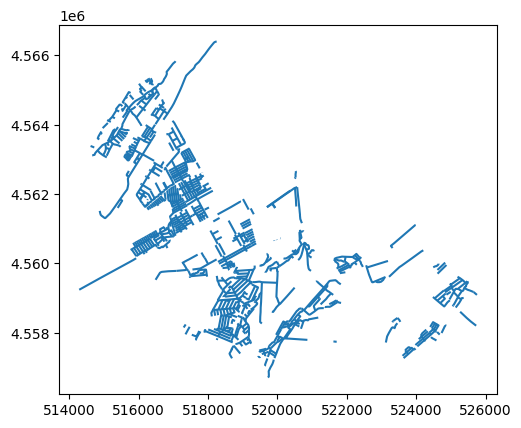

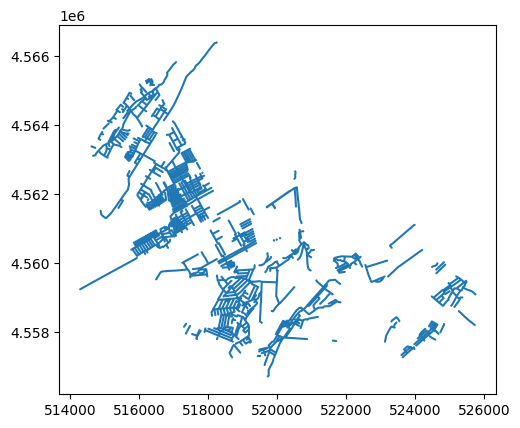

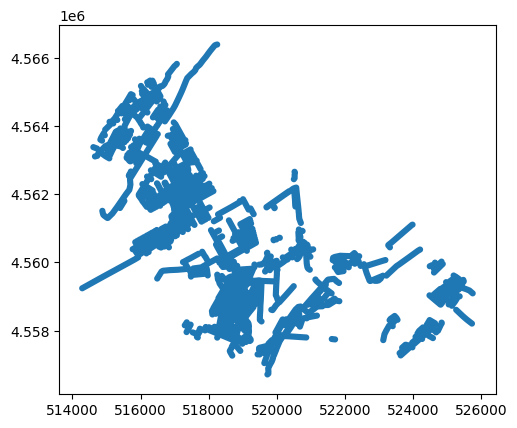

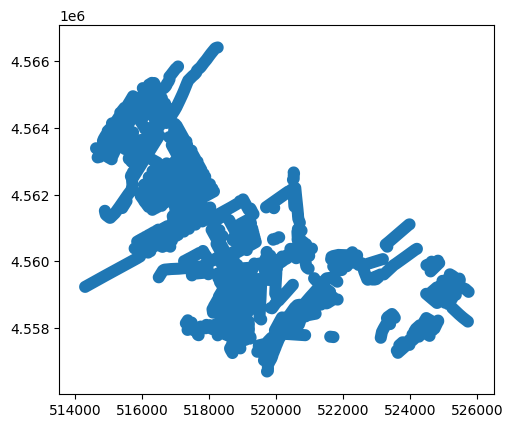

In [2084]:
roads_cat1.plot()
buffered_cat1_30.plot()
buffered_cat1_60.plot()
buffered_cat1_90.plot()

<Axes: >

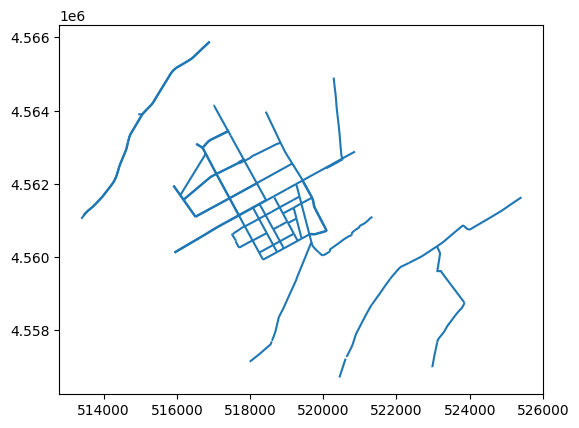

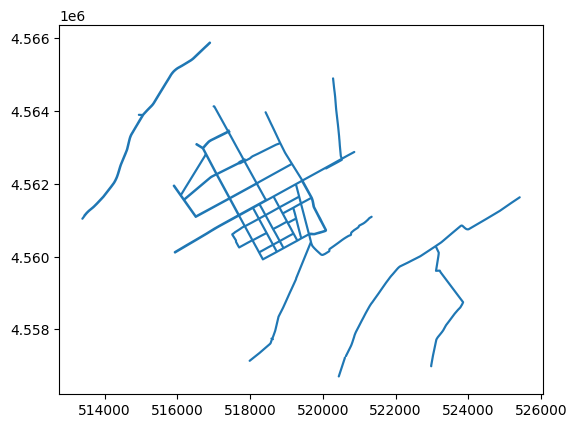

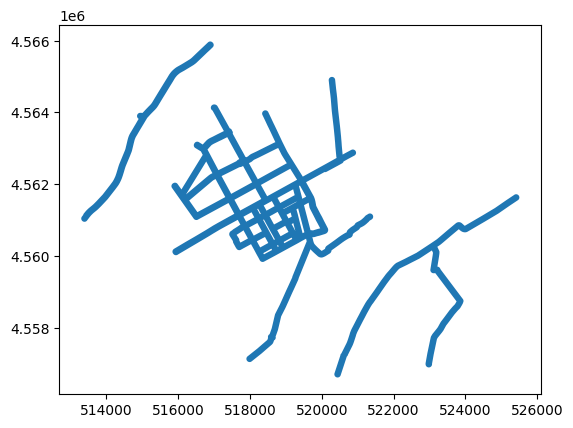

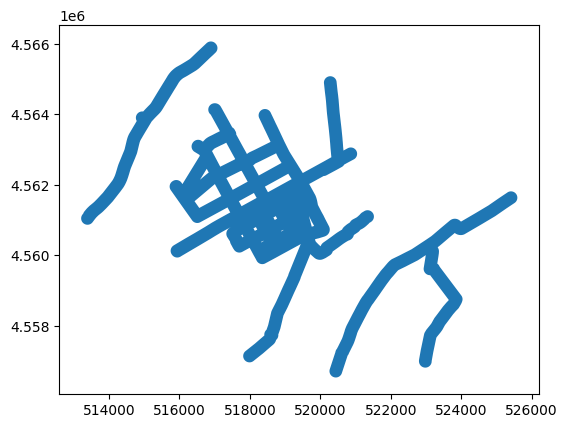

In [2085]:
roads_cat2.plot()
buffered_cat2_30.plot()
buffered_cat2_60.plot()
buffered_cat2_90.plot()

<Axes: >

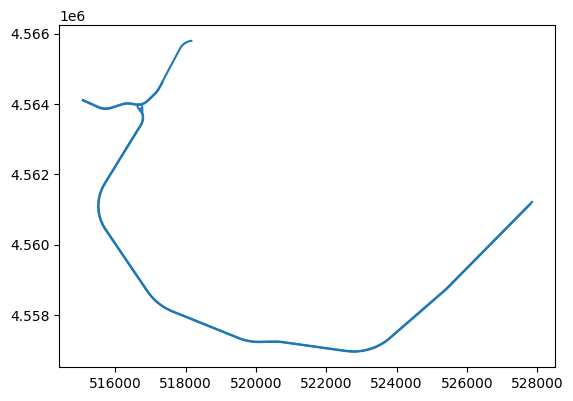

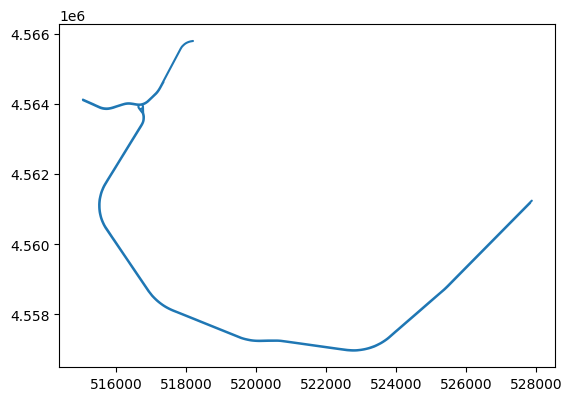

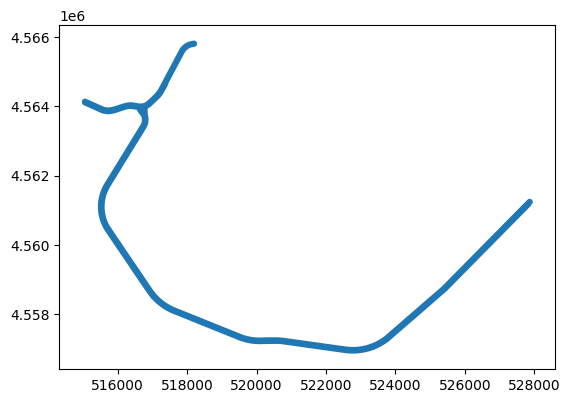

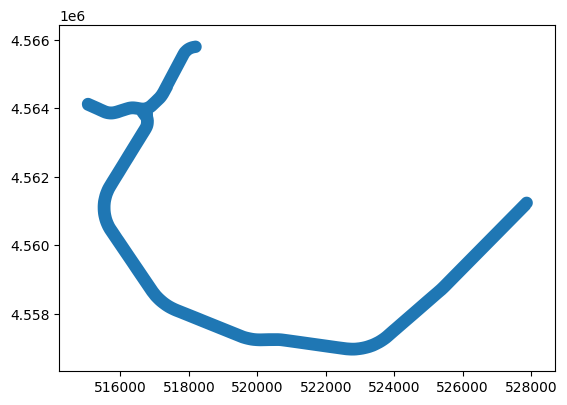

In [2086]:
roads_cat3.plot()
buffered_cat3_30.plot()
buffered_cat3_60.plot()
buffered_cat3_90.plot()

<Axes: >

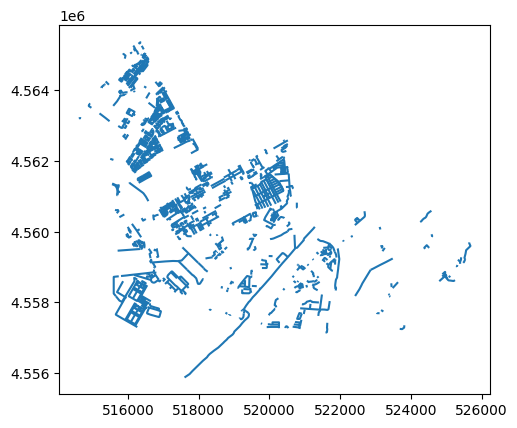

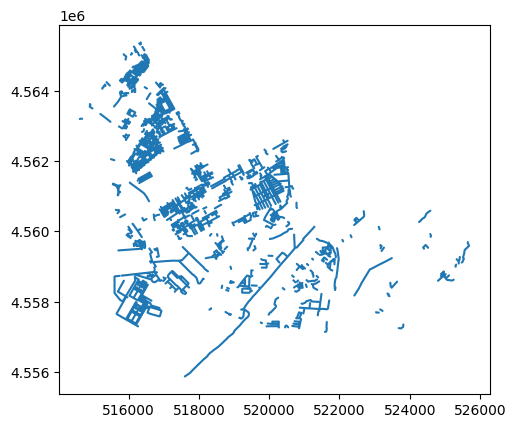

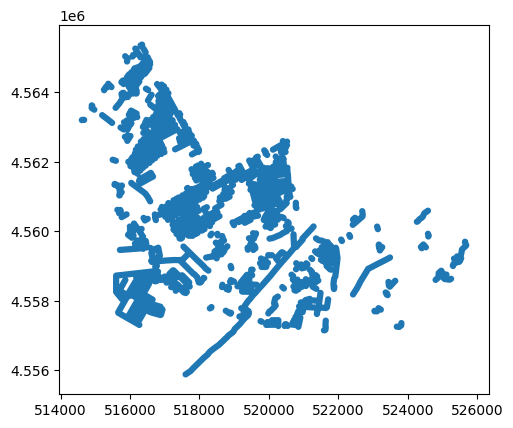

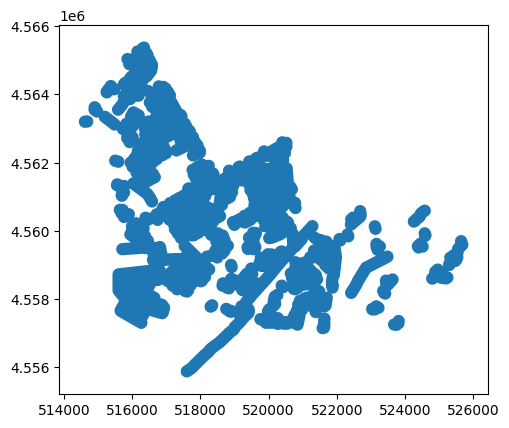

In [2087]:
roads_cat4.plot()
buffered_cat4_30.plot()
buffered_cat4_60.plot()
buffered_cat4_90.plot()

In [2088]:
def join_buildings(buffer_category, roads_category):
    buffered_category = {
        'cat1_30': buffered_cat1_30,
        'cat1_60': buffered_cat1_60,
        'cat1_90': buffered_cat1_90,
        'cat2_30': buffered_cat2_30,
        'cat2_60': buffered_cat2_60,
        'cat2_90': buffered_cat2_90,
        'cat3_30': buffered_cat3_30,
        'cat3_60': buffered_cat3_60,
        'cat3_90': buffered_cat3_90,
        'cat4_30': buffered_cat4_30,
        'cat4_60': buffered_cat4_60,
        'cat4_90': buffered_cat4_90,

    }.get(buffer_category)

    joined = buildings_gdf.sjoin(buffered_category, how='left')
    #joined = buildings_gdf.sjoin(buffered_category, how="left", predicate='intersects')
    joined.rename(columns={'index_right': 'index_roads'}, inplace=True)
    #joined.drop_duplicates(subset='id_left',inplace=True)
    if roads_category:
        joined['buffered_highway'] = \
            joined['buffered_highway'].apply(lambda x: 'not_residential' if pd.isnull(x) else x)
    else:
        joined['buffered_highway'] = \
            joined['buffered_highway'].apply(lambda x: 'residential' if pd.isnull(x) else x)

    joined.reset_index(inplace=True, drop=True)
    
    return joined

In [2089]:
buffer_categories = ['cat1_30', 'cat1_60', 'cat1_90','cat2_30','cat2_60','cat2_90',\
                    'cat3_30', 'cat3_60', 'cat3_90','cat4_30','cat4_60','cat4_90']
roads_category = 1                      # 1 is residential, 0 is ['primary', 'secondary','tertiary']
joined_buildings1 = join_buildings(buffer_categories[0],roads_category)
joined_buildings2 = join_buildings(buffer_categories[1],roads_category)
joined_buildings3 = join_buildings(buffer_categories[2],roads_category)
roads_category = 0
joined_buildings4 = join_buildings(buffer_categories[3],roads_category)
joined_buildings5 = join_buildings(buffer_categories[4],roads_category)
joined_buildings6 = join_buildings(buffer_categories[5],roads_category)
joined_buildings7 = join_buildings(buffer_categories[6],roads_category)
joined_buildings8 = join_buildings(buffer_categories[7],roads_category)
joined_buildings9 = join_buildings(buffer_categories[8],roads_category)
joined_buildings10 = join_buildings(buffer_categories[9],roads_category)
joined_buildings11 = join_buildings(buffer_categories[10],roads_category)
joined_buildings12 = join_buildings(buffer_categories[11],roads_category)

In [2090]:
print(joined_buildings1.shape)
print(joined_buildings2.shape)
print(joined_buildings3.shape)
print(joined_buildings4.shape)
print(joined_buildings5.shape)
print(joined_buildings6.shape)
print(joined_buildings7.shape)
print(joined_buildings8.shape)
print(joined_buildings9.shape)
print(joined_buildings10.shape)
print(joined_buildings11.shape)
print(joined_buildings12.shape)

(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)
(9074, 11)


In [2091]:
# joined_buildings1.groupby('is_living').count()

In [2092]:
joined_buildings1.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
not_residential,3063,3063,3063,3063,3063,2922,3063,3063,0,0
residential,6011,6011,6011,6011,6011,5987,6011,6011,6011,6011


In [2093]:
joined_buildings1[(joined_buildings1['land_building'] == 'commercial')\
               &(joined_buildings1['buffered_highway'] == 'residential')].shape

(0, 11)

In [2094]:
joined_buildings2.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
not_residential,1236,1236,1236,1236,1236,1138,1236,1236,0,0
residential,7838,7838,7838,7838,7838,7771,7838,7838,7838,7838


In [2095]:
joined_buildings3.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
not_residential,451,451,451,451,451,406,451,451,0,0
residential,8623,8623,8623,8623,8623,8503,8623,8623,8623,8623


In [2096]:
joined_buildings4.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
non_res_road,1143,1143,1143,1143,1143,1106,1143,1143,1143,1143
residential,7931,7931,7931,7931,7931,7803,7931,7931,0,0


In [2097]:
joined_buildings5.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
non_res_road,3206,3206,3206,3206,3206,3143,3206,3206,3206,3206
residential,5868,5868,5868,5868,5868,5766,5868,5868,0,0


In [2098]:
joined_buildings6.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
non_res_road,5157,5157,5157,5157,5157,5065,5157,5157,5157,5157
residential,3917,3917,3917,3917,3917,3844,3917,3917,0,0


In [2099]:
joined_buildings7.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
residential,9046,9046,9046,9046,9046,8885,9046,9046,0,0
roads_cat3,28,28,28,28,28,24,28,28,28,28


In [2100]:
joined_buildings8.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
residential,8779,8779,8779,8779,8779,8635,8779,8779,0,0
roads_cat3,295,295,295,295,295,274,295,295,295,295


In [2101]:
joined_buildings9.groupby(['buffered_highway']).count()

,id_left,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building,index_roads,id_right
buffered_highway,,,,,,,,,,
residential,8346,8346,8346,8346,8346,8222,8346,8346,0,0
roads_cat3,728,728,728,728,728,687,728,728,728,728


### Key list

In [2102]:
buildings_gdf

,id,building,geometry,all_tag_keys,all_tags,index_landuse,landuse,land_building
0,1425721,school,"POLYGON ((517578.048 4560751.784, 517567.767 4...","[building, type]","{'building': 'school', 'type': 'multipolygon'}",51.0,residential,residential
1,1521832,yes,"POLYGON ((518271.547 4560795.23, 518268.381 45...","[building, addr:place, building:levels, type]","{'building': 'yes', 'addr:place': 'Birodarlik ...",7.0,residential,residential
2,1861294,school,"POLYGON ((515984.292 4564943.259, 515967.686 4...","[building, addr:housenumber, type]","{'building': 'school', 'addr:housenumber': '26...",NaN,no_landuse,school
3,2145523,school,"POLYGON ((517756.789 4560397.827, 517766.013 4...","[building, building:levels, type]","{'building': 'school', 'building:levels': '3',...",52.0,residential,residential
4,2145524,yes,"POLYGON ((517535.412 4560876.517, 517527.08 45...","[building, addr:place, type]","{'building': 'yes', 'addr:place': 'Sputnik 16 ...",51.0,residential,residential
...,...,...,...,...,...,...,...,...
9069,1382084342,yes,"POLYGON ((518931.317 4560953.331, 518948.682 4...","[building, building:levels]","{'building': 'yes', 'building:levels': '1'}",8.0,residential,residential
9070,1382084343,yes,"POLYGON ((518893.477 4561069.854, 518926.593 4...","[building, addr:place]","{'building': 'yes', 'addr:place': 'Birodarlik ...",8.0,residential,residential
9071,1382084344,yes,"POLYGON ((518844.795 4561102.732, 518828.048 4...",[building],{'building': 'yes'},8.0,residential,residential
9072,1382084345,yes,"POLYGON ((518909.196 4561131.973, 518864.809 4...",[building],{'building': 'yes'},8.0,residential,residential


In [2103]:
keys_list = buildings_gdf['all_tag_keys'].tolist()

In [2104]:
keys_list

[['building', 'type'],
 ['building', 'addr:place', 'building:levels', 'type'],
 ['building', 'addr:housenumber', 'type'],
 ['building', 'building:levels', 'type'],
 ['building', 'addr:place', 'type'],
 ['building', 'addr:place', 'type'],
 ['building', 'addr:housenumber', 'building:levels', 'type'],
 ['building', 'addr:housenumber', 'building:levels', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'type'],
 ['building', 'ty

In [2105]:
keys_list_flat = [val for sublist in keys_list for val in sublist]

In [2106]:
unique_keys = sorted(list(set(keys_list_flat)))

In [2107]:
key_freq = []
for key in unique_keys:
    key_freq.append(keys_list_flat.count(key))

In [2108]:
len(key_freq)

44

In [2109]:
keys_tuples = list(zip(unique_keys, key_freq))
keys_freq_df = pd.DataFrame(keys_tuples, columns = ['Key', 'Freq'])

In [2110]:
keys_freq_df.sort_values(by=['Freq'], inplace=True, ascending=False)

In [2111]:
keys_freq_df.reset_index(inplace=True, drop=True)

In [2112]:
keys_freq_df.head()

,Key,Freq
0,building,9074
1,building:levels,1269
2,addr:housenumber,983
3,addr:place,756
4,addr:postcode,86


In [2113]:
keys_freq_df.sort_values(by=['Key'], inplace=False, ascending=True).head(20)

,Key,Freq
8,addr:city,27
15,addr:country,6
2,addr:housenumber,983
3,addr:place,756
26,addr:place:ru,2
4,addr:postcode,86
6,addr:street,49
39,alt_name,1
10,amenity,17
0,building,9074


In [2114]:
keys_freq_df.head(21)

,Key,Freq
0,building,9074
1,building:levels,1269
2,addr:housenumber,983
3,addr:place,756
4,addr:postcode,86
5,type,54
6,addr:street,49
7,name,33
8,addr:city,27
9,man_made,24


In [2115]:
selected_tags = ['source','addr:street','name','building:levels',\
                'roof:shape','amenity','brand','website','shop']
num_keys = len(selected_tags)+2

In [2116]:
len(selected_tags)

9

In [2117]:
def preprocess_data(input_data, value_tags, selected_tags):
    col_pos = 2
    for tag_key in selected_tags:
        col_name = tag_key
        input_data.insert(col_pos,col_name,0)
        input_data[col_name] = input_data.apply(lambda x: 1 if tag_key in list(x['all_tag_keys']) \
            else 0, axis=1)

    for tag_key in value_tags:
        input_data[tag_key] = input_data.apply(lambda x: x['all_tags'].get(tag_key) \
            if tag_key in list(x['all_tag_keys']) else 0, axis=1)

    # fix anomalies in FFX County data
    input_data.drop(input_data[(input_data['building:levels'] == 'K-6')].index, inplace=True)
    input_data.loc[(input_data['building:levels'] == '-1,1,2,3'),'building:levels']=4

    input_data.drop(columns=['all_tag_keys', 'all_tags'], inplace=True)

    # input_data['is_living'] = \
    # input_data['is_living'].apply(lambda x: 1 if x == 'RES' else 0)

    return input_data

In [2118]:
def add_buffers(input_data,col_names, buffers_list):
    for num in range(0, len(col_names)):
        input_data.insert(num+2,col_names[num],buffers_list[num])
        input_data[col_names[num]] = input_data[col_names[num]].apply(lambda x: 1 if x == 'residential' else 0)

    return input_data

In [2119]:
#num_buffers = 6
#buffer_loc = 0
#value_tags = ['roof:shape','building:levels']
#col_names = ['buffer_cat1_30','buffer_cat1_60','buffer_cat1_90',\
#            'buffer_cat2_30','buffer_cat2_60','buffer_cat2_90']
#buffers_list = [joined_buildings1['buffered_highway'],joined_buildings2['buffered_highway'],\
#                joined_buildings3['buffered_highway'],joined_buildings4['buffered_highway'],\
#                joined_buildings5['buffered_highway'],joined_buildings6['buffered_highway']]

num_buffers = 12
buffer_loc = 0
value_tags = ['roof:shape','building:levels']
col_names = ['buffer_cat1_30','buffer_cat1_60','buffer_cat1_90',\
            'buffer_cat2_30','buffer_cat2_60','buffer_cat2_90',\
            'buffer_cat3_30','buffer_cat3_60','buffer_cat3_90',\
            'buffer_cat4_30','buffer_cat4_60','buffer_cat4_90']
buffers_list = [joined_buildings1['buffered_highway'],joined_buildings2['buffered_highway'],\
                joined_buildings3['buffered_highway'],joined_buildings4['buffered_highway'],\
                joined_buildings5['buffered_highway'],joined_buildings6['buffered_highway'],\
                joined_buildings7['buffered_highway'],joined_buildings8['buffered_highway'],\
                joined_buildings9['buffered_highway'],joined_buildings10['buffered_highway'],\
                joined_buildings11['buffered_highway'],joined_buildings12['buffered_highway']]
backup_data = joined_buildings1.copy()
#input_data = input_data[['geometry','official_type','land_building','all_tag_keys','all_tags']]
#input_data = input_data[['geometry','official_type','building','landuse','all_tag_keys','all_tags']]
#input_data = input_data[['geometry','official_type','building','landuse',\
#                        'all_tag_keys','all_tags','id_left']]
#input_data = input_data[['geometry','official_type','building','landuse','amenity_key','parking_area',\
#                        'all_tag_keys','all_tags']]
backup_data = backup_data[['geometry','building','landuse','land_building',\
                        'all_tag_keys','all_tags','id_left']]
backup_data.insert(len(backup_data.columns), 'area',backup_data['geometry'].to_crs(local_crs).area)
backup_data = preprocess_data(backup_data,value_tags,selected_tags)

backup_data = add_buffers(backup_data,col_names[buffer_loc:buffer_loc+num_buffers],\
                         buffers_list[buffer_loc:buffer_loc+num_buffers])

### Amenities

In [2120]:
amenity_tag = {'amenity': True}

In [2121]:
gdf_amenity = ox.features_from_polygon(bounds, amenity_tag)

In [2122]:
gdf_amenity.reset_index(inplace=True)
gdf_amenity

,element,id,geometry,amenity,name,name:ru,ref,addr:street,addr:postcode,name:en,...,bus,healthcare:speciality,landuse,old_name:ru,layer,fence_type,emergency,building:levels,area,type
0,node,1516138875,POINT (69.17898 41.22585),bus_station,Internet Solutions Group,Эркин,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,node,1812175744,POINT (69.21368 41.20532),post_office,Почтовое отделение №209,Почтовое отделение №209,209,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,node,1814575220,POINT (69.22237 41.19724),fire_station,ОПБ Сергилийского района (ПЧ-8),NaN,NaN,Полвонёр улица,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,node,1821191203,POINT (69.22496 41.20191),public_building,Энергосбыт Сергели,Энергосбыт Серглли,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,node,1821191204,POINT (69.22482 41.20205),public_building,"махаллинский комитет ""Ал-Фаргоний""","махаллинский комитет ""Ал-Фаргоний""",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
221,way,1382050823,"POLYGON ((69.21877 41.20476, 69.2187 41.20485,...",parking,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
222,way,1382050824,"POLYGON ((69.21545 41.20372, 69.21556 41.20357...",parking,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
223,way,1382050826,"POLYGON ((69.21933 41.20521, 69.21933 41.20521...",fountain,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
224,way,1382050829,"POLYGON ((69.21516 41.21143, 69.21483 41.21187...",parking,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [2123]:
gdf_amenity.to_crs(local_crs, inplace=True)

In [2124]:
gdf_amenity = gdf_amenity[['amenity', 'geometry']]
gdf_amenity = gdf_amenity.rename(columns={'amenity': 'amenity_key'})
gdf_amenity

,amenity_key,geometry
0,bus_station,POINT (515001.316 4563843.99)
1,post_office,POINT (517914.955 4561571.722)
2,fire_station,POINT (518646.003 4560676.56)
3,public_building,POINT (518862.027 4561196.14)
4,public_building,POINT (518850.114 4561211.518)
...,...,...
221,parking,"POLYGON ((518341.774 4561510.504, 518335.888 4..."
222,parking,"POLYGON ((518064.093 4561395.1, 518072.945 456..."
223,fountain,"POLYGON ((518388.398 4561560.456, 518389.008 4..."
224,parking,"POLYGON ((518037.696 4562250.399, 518009.582 4..."


In [2125]:
gdf_amenity.shape

(226, 2)

In [2126]:
amenity_categories = gdf_amenity.groupby(['amenity_key'])['geometry'].count().reset_index(name="count")

In [2127]:
amenity_categories.tail(50)

,amenity_key,count
0,atm,14
1,bank,3
2,bar,1
3,bicycle_parking,1
4,bus_station,5
5,cafe,9
6,car_wash,5
7,charging_station,5
8,clinic,2
9,college,2


In [2128]:
parking_gdf = gdf_amenity[(gdf_amenity['amenity_key'] == 'parking') | (gdf_amenity['amenity_key'] == 'parking_space')]

In [2129]:
parking_gdf.geom_type.unique()

array(['Point', 'Polygon'], dtype=object)

In [2130]:
parking_gdf = parking_gdf[~parking_gdf.geometry.geom_type.isin(['Point'])]

In [2131]:
parking_gdf = parking_gdf.assign(amenity_key='parking')

In [2132]:
parking_gdf

,amenity_key,geometry
113,parking,"POLYGON ((519656.581 4561579.694, 519673.417 4..."
135,parking,"POLYGON ((517912.958 4561842.048, 517963.306 4..."
144,parking,"POLYGON ((517693.497 4560674.131, 517717.566 4..."
146,parking,"POLYGON ((517413.825 4560222.486, 517448.337 4..."
152,parking,"POLYGON ((515911.711 4563876.372, 515867.111 4..."
153,parking,"POLYGON ((515954.164 4563891.241, 516117.36 45..."
157,parking,"POLYGON ((520361.817 4562110.758, 520363.331 4..."
158,parking,"POLYGON ((520197.102 4561991.481, 520199.536 4..."
159,parking,"POLYGON ((520280.267 4562109.165, 520301.677 4..."
167,parking,"POLYGON ((518221.156 4561310.798, 518297.783 4..."


In [2133]:
parking_gdf.reset_index(inplace=True, drop=True)

In [2134]:
parking_gdf.shape

(49, 2)

In [2135]:
parking_gdf.insert(len(parking_gdf.columns), 'parking_area',parking_gdf['geometry'].to_crs(local_crs).area)

In [2136]:
parking_gdf

,amenity_key,geometry,parking_area
0,parking,"POLYGON ((519656.581 4561579.694, 519673.417 4...",2449.145557
1,parking,"POLYGON ((517912.958 4561842.048, 517963.306 4...",4246.575738
2,parking,"POLYGON ((517693.497 4560674.131, 517717.566 4...",900.048241
3,parking,"POLYGON ((517413.825 4560222.486, 517448.337 4...",4015.030003
4,parking,"POLYGON ((515911.711 4563876.372, 515867.111 4...",1687.101641
5,parking,"POLYGON ((515954.164 4563891.241, 516117.36 45...",1879.238424
6,parking,"POLYGON ((520361.817 4562110.758, 520363.331 4...",1240.809732
7,parking,"POLYGON ((520197.102 4561991.481, 520199.536 4...",810.712360
8,parking,"POLYGON ((520280.267 4562109.165, 520301.677 4...",1354.687461
9,parking,"POLYGON ((518221.156 4561310.798, 518297.783 4...",1708.318287


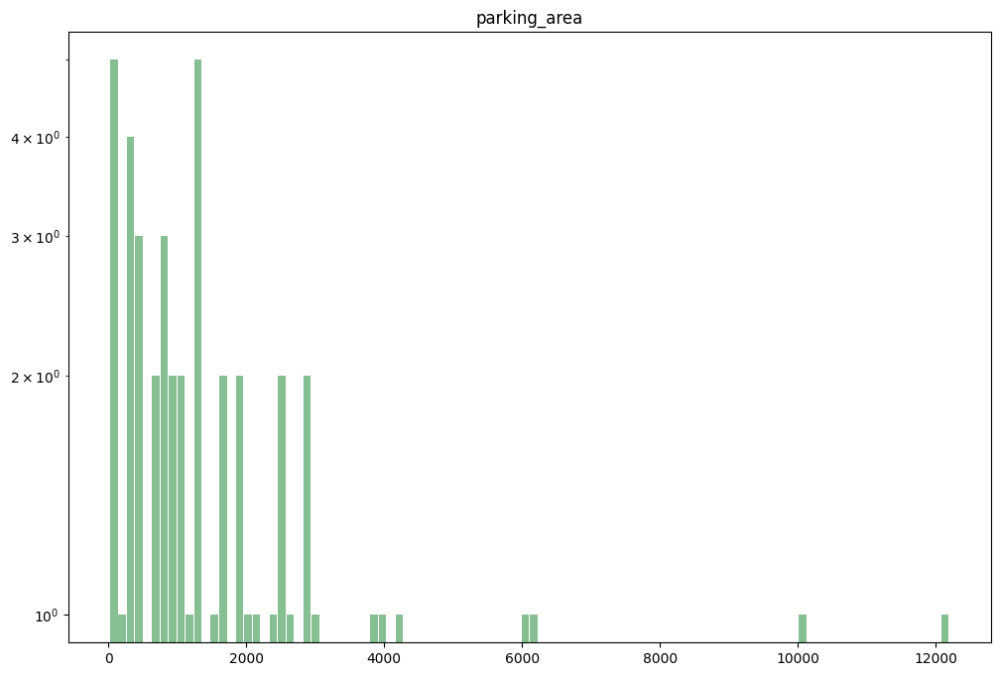

In [2137]:
hist = parking_gdf.hist(bins=100, grid=False, figsize=(12,8), color='#86bf91', zorder=2, rwidth=0.9)
plt.yscale('log')

In [2138]:
breaks = jenkspy.jenks_breaks(parking_gdf['parking_area'], n_classes=3)
print(breaks)

[np.float64(18.206498465786588), np.float64(2161.9420696011493), np.float64(6191.325790943534), np.float64(12197.899650898667)]


In [2139]:
bins_list = ['bin1','bin2','bin3']
parking_gdf['cut_jenks'] = pd.cut(parking_gdf['parking_area'],
                                bins=breaks,
                                labels=bins_list,
                                include_lowest=True)
                                # duplicates='drop')

In [2140]:
parking_gdf

,amenity_key,geometry,parking_area,cut_jenks
0,parking,"POLYGON ((519656.581 4561579.694, 519673.417 4...",2449.145557,bin2
1,parking,"POLYGON ((517912.958 4561842.048, 517963.306 4...",4246.575738,bin2
2,parking,"POLYGON ((517693.497 4560674.131, 517717.566 4...",900.048241,bin1
3,parking,"POLYGON ((517413.825 4560222.486, 517448.337 4...",4015.030003,bin2
4,parking,"POLYGON ((515911.711 4563876.372, 515867.111 4...",1687.101641,bin1
5,parking,"POLYGON ((515954.164 4563891.241, 516117.36 45...",1879.238424,bin1
6,parking,"POLYGON ((520361.817 4562110.758, 520363.331 4...",1240.809732,bin1
7,parking,"POLYGON ((520197.102 4561991.481, 520199.536 4...",810.712360,bin1
8,parking,"POLYGON ((520280.267 4562109.165, 520301.677 4...",1354.687461,bin1
9,parking,"POLYGON ((518221.156 4561310.798, 518297.783 4...",1708.318287,bin1


In [2141]:
for bin in bins_list:
    parking_gdf.insert(len(parking_gdf.columns),bin,0)
    parking_gdf[bin] = parking_gdf.apply(lambda x: 1 if x['cut_jenks'] == bin\
                                     else 0, axis=1)

In [2142]:
parking_gdf.head()

,amenity_key,geometry,parking_area,cut_jenks,bin1,bin2,bin3
0,parking,"POLYGON ((519656.581 4561579.694, 519673.417 4...",2449.145557,bin2,0,1,0
1,parking,"POLYGON ((517912.958 4561842.048, 517963.306 4...",4246.575738,bin2,0,1,0
2,parking,"POLYGON ((517693.497 4560674.131, 517717.566 4...",900.048241,bin1,1,0,0
3,parking,"POLYGON ((517413.825 4560222.486, 517448.337 4...",4015.030003,bin2,0,1,0
4,parking,"POLYGON ((515911.711 4563876.372, 515867.111 4...",1687.101641,bin1,1,0,0


In [2143]:
backup_data.columns

Index(['geometry', 'building', 'buffer_cat1_30', 'buffer_cat1_60',
       'buffer_cat1_90', 'buffer_cat2_30', 'buffer_cat2_60', 'buffer_cat2_90',
       'buffer_cat3_30', 'buffer_cat3_60', 'buffer_cat3_90', 'buffer_cat4_30',
       'buffer_cat4_60', 'buffer_cat4_90', 'shop', 'website', 'brand',
       'amenity', 'roof:shape', 'building:levels', 'name', 'addr:street',
       'source', 'landuse', 'land_building', 'id_left', 'area'],
      dtype='object')

In [2144]:
radius_list = [30,60,90]
counter = 1
for bin in bins_list:
    for radius in radius_list:
        parking_buffer = parking_gdf.copy()
        parking_buffer = parking_buffer[['geometry',bin]]
        col_name = 'parking_cat'+str(counter)
        counter += 1
        parking_buffer.rename(columns={bin: col_name}, inplace=True)
        parking_buffer['geometry'] = parking_buffer['geometry'].to_crs(local_crs).buffer(radius)
        parking_buffer.to_crs(local_crs, inplace=True)
        buildings_parking = backup_data.sjoin(parking_buffer, how="left", predicate='intersects')
        buildings_parking[col_name] = buildings_parking[col_name].fillna(0)
        buildings_parking.drop_duplicates(subset='id_left',inplace=True)
        buildings_parking.reset_index(inplace=True, drop=True)
        backup_data.insert(len(backup_data.columns),col_name,list(buildings_parking[col_name]))

In [2145]:
backup_data.drop(columns=['id_left'], inplace=True)

In [2146]:
backup_data.shape

(9074, 35)

In [2147]:
backup_data.head()

,geometry,building,buffer_cat1_30,buffer_cat1_60,buffer_cat1_90,buffer_cat2_30,buffer_cat2_60,buffer_cat2_90,buffer_cat3_30,buffer_cat3_60,...,area,parking_cat1,parking_cat2,parking_cat3,parking_cat4,parking_cat5,parking_cat6,parking_cat7,parking_cat8,parking_cat9
0,"POLYGON ((517578.048 4560751.784, 517567.767 4...",school,0,0,0,0,0,0,1,1,...,3990.220753,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,"POLYGON ((518271.547 4560795.23, 518268.381 45...",yes,1,1,1,1,0,0,1,1,...,3953.378560,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,"POLYGON ((515984.292 4564943.259, 515967.686 4...",school,1,1,1,1,1,0,1,1,...,3264.515382,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,"POLYGON ((517756.789 4560397.827, 517766.013 4...",school,0,1,1,1,0,0,1,1,...,3778.673158,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,"POLYGON ((517535.412 4560876.517, 517527.08 45...",yes,0,0,1,1,1,0,1,1,...,1767.100184,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Saving backup

In [2151]:
backup_data['building:levels'].unique()

array([0, '3', '4', '2', '9', '1', '5', '10', '7', '19', '16', '12', '6',
       '17', '8'], dtype=object)

In [2149]:
backup_data.loc[(backup_data['building:levels'] == '1;2;4'),'building:levels']=4
backup_data.loc[(backup_data['building:levels'] == '1;3;2'),'building:levels']=3
backup_data.loc[(backup_data['building:levels'] == '4 floors'),'building:levels']=4
backup_data.loc[(backup_data['building:levels'] == '4.5'),'building:levels']=4
backup_data.loc[(backup_data['building:levels'] == '7;4;4'),'building:levels']=7
backup_data.loc[(backup_data['building:levels'] == '2.5'),'building:levels']=2
backup_data.loc[(backup_data['building:levels'] == '3.5'),'building:levels']=3
backup_data.loc[(backup_data['building:levels'] == '3;5'),'building:levels']=5
backup_data.loc[(backup_data['building:levels'] == '7.5'),'building:levels']=7
backup_data.loc[(backup_data['building:levels'] == '1.5'),'building:levels']=1 
backup_data.loc[(backup_data['building:levels'] == '5; 6'),'building:levels']=5
backup_data.loc[(backup_data['building:levels'] == '0.5'),'building:levels']=1
backup_data.loc[backup_data['building:levels'] == 'yes', 'building:levels'] = 0
backup_data.loc[(backup_data['building:levels'] == '1;4'),'building:levels']=4
backup_data.loc[(backup_data['building:levels'] == '3;4'),'building:levels']=4
backup_data.loc[(backup_data['building:levels'] == 'ё'),'building:levels']=0
backup_data.loc[(backup_data['building:levels'] == '`'),'building:levels']=0
backup_data.loc[(backup_data['building:levels'] == 'Ё0'),'building:levels']=0
backup_data.loc[(backup_data['building:levels'] == '1-'),'building:levels']=1

In [2152]:
backup_data.to_pickle("./Datasets/Toshkent/backup_Янгихаётский_район.pickle") 

### Separating OSM data features

In [2153]:
input_data = backup_data.copy()

In [2154]:
input_data.columns

Index(['geometry', 'building', 'buffer_cat1_30', 'buffer_cat1_60',
       'buffer_cat1_90', 'buffer_cat2_30', 'buffer_cat2_60', 'buffer_cat2_90',
       'buffer_cat3_30', 'buffer_cat3_60', 'buffer_cat3_90', 'buffer_cat4_30',
       'buffer_cat4_60', 'buffer_cat4_90', 'shop', 'website', 'brand',
       'amenity', 'roof:shape', 'building:levels', 'name', 'addr:street',
       'source', 'landuse', 'land_building', 'area', 'parking_cat1',
       'parking_cat2', 'parking_cat3', 'parking_cat4', 'parking_cat5',
       'parking_cat6', 'parking_cat7', 'parking_cat8', 'parking_cat9'],
      dtype='object')

In [2155]:
input_data.drop(columns=['land_building', 'roof:shape'], inplace=True)

In [2156]:
input_data.columns

Index(['geometry', 'building', 'buffer_cat1_30', 'buffer_cat1_60',
       'buffer_cat1_90', 'buffer_cat2_30', 'buffer_cat2_60', 'buffer_cat2_90',
       'buffer_cat3_30', 'buffer_cat3_60', 'buffer_cat3_90', 'buffer_cat4_30',
       'buffer_cat4_60', 'buffer_cat4_90', 'shop', 'website', 'brand',
       'amenity', 'building:levels', 'name', 'addr:street', 'source',
       'landuse', 'area', 'parking_cat1', 'parking_cat2', 'parking_cat3',
       'parking_cat4', 'parking_cat5', 'parking_cat6', 'parking_cat7',
       'parking_cat8', 'parking_cat9'],
      dtype='object')

In [2157]:
input_data.groupby('landuse').count().sort_values(by=['geometry'], inplace=False, ascending=False).head(50)

,geometry,building,buffer_cat1_30,buffer_cat1_60,buffer_cat1_90,buffer_cat2_30,buffer_cat2_60,buffer_cat2_90,buffer_cat3_30,buffer_cat3_60,...,area,parking_cat1,parking_cat2,parking_cat3,parking_cat4,parking_cat5,parking_cat6,parking_cat7,parking_cat8,parking_cat9
landuse,,,,,,,,,,,,,,,,,,,,,
residential,8221,8221,8221,8221,8221,8221,8221,8221,8221,8221,...,8221,8221,8221,8221,8221,8221,8221,8221,8221,8221
non_res,554,554,554,554,554,554,554,554,554,554,...,554,554,554,554,554,554,554,554,554,554
no_landuse,165,165,165,165,165,165,165,165,165,165,...,165,165,165,165,165,165,165,165,165,165
construction,106,106,106,106,106,106,106,106,106,106,...,106,106,106,106,106,106,106,106,106,106
farmland,14,14,14,14,14,14,14,14,14,14,...,14,14,14,14,14,14,14,14,14,14
military,6,6,6,6,6,6,6,6,6,6,...,6,6,6,6,6,6,6,6,6,6
cemetery,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4
forest,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3
orchard,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


In [2158]:
input_data['landuse'].unique()

array(['residential', 'no_landuse', 'non_res', 'construction', 'farmland',
       'military', 'cemetery', 'orchard', 'forest'], dtype=object)

In [2159]:
input_data.shape

(9074, 33)

In [2160]:
input_data.groupby('building').count().sort_values(by=['geometry'], inplace=False, ascending=False).head(20)

,geometry,buffer_cat1_30,buffer_cat1_60,buffer_cat1_90,buffer_cat2_30,buffer_cat2_60,buffer_cat2_90,buffer_cat3_30,buffer_cat3_60,buffer_cat3_90,...,area,parking_cat1,parking_cat2,parking_cat3,parking_cat4,parking_cat5,parking_cat6,parking_cat7,parking_cat8,parking_cat9
building,,,,,,,,,,,,,,,,,,,,,
yes,8946,8946,8946,8946,8946,8946,8946,8946,8946,8946,...,8946,8946,8946,8946,8946,8946,8946,8946,8946,8946
apartments,46,46,46,46,46,46,46,46,46,46,...,46,46,46,46,46,46,46,46,46,46
house,22,22,22,22,22,22,22,22,22,22,...,22,22,22,22,22,22,22,22,22,22
industrial,15,15,15,15,15,15,15,15,15,15,...,15,15,15,15,15,15,15,15,15,15
construction,11,11,11,11,11,11,11,11,11,11,...,11,11,11,11,11,11,11,11,11,11
school,10,10,10,10,10,10,10,10,10,10,...,10,10,10,10,10,10,10,10,10,10
garage,5,5,5,5,5,5,5,5,5,5,...,5,5,5,5,5,5,5,5,5,5
kindergarten,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4
roof,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4


In [2161]:
input_data['building'].unique()

array(['school', 'yes', 'college', 'house', 'commercial', 'apartments',
       'public', 'residential', 'train_station', 'kindergarten', 'garage',
       'industrial', 'service', 'construction', 'roof', 'shop', 'cafe',
       'warehouse', 'greenhouse'], dtype=object)

In [2162]:
common_features = np.array(['apartments', 'church', 'civic', 'commercial', 'construction',
       'detached', 'dormitory', 'garage', 'garages', 'greenhouse',
       'hospital', 'hotel', 'house', 'industrial', 'kindergarten',
       'office', 'parking', 'public', 'residential', 'retail', 'roof',
       'school', 'semidetached_house', 'service', 'shed',
       'static_caravan', 'terrace', 'warehouse', 'yes'], dtype=object)

In [2163]:
unique_buildings = np.setxor1d(input_data['building'].unique(), common_features).tolist()

In [2164]:
unique_buildings

['cafe',
 'church',
 'civic',
 'college',
 'detached',
 'dormitory',
 'garages',
 'hospital',
 'hotel',
 'office',
 'parking',
 'retail',
 'semidetached_house',
 'shed',
 'shop',
 'static_caravan',
 'terrace',
 'train_station']

In [2165]:
len(unique_buildings)

18

In [2166]:
input_data[input_data['building'].isin(unique_buildings)].shape

(5, 33)

In [2167]:
input_data['building'] = input_data['building'].apply(\
                                lambda x: 'misc_buildings' if x in(unique_buildings)
                                                else x)

In [2168]:
input_data[input_data['building'].isin(unique_buildings)].shape

(0, 33)

In [2169]:
input_data.groupby('building').count().sort_values(by=['geometry'], inplace=False, ascending=False).head(50)

,geometry,buffer_cat1_30,buffer_cat1_60,buffer_cat1_90,buffer_cat2_30,buffer_cat2_60,buffer_cat2_90,buffer_cat3_30,buffer_cat3_60,buffer_cat3_90,...,area,parking_cat1,parking_cat2,parking_cat3,parking_cat4,parking_cat5,parking_cat6,parking_cat7,parking_cat8,parking_cat9
building,,,,,,,,,,,,,,,,,,,,,
yes,8946,8946,8946,8946,8946,8946,8946,8946,8946,8946,...,8946,8946,8946,8946,8946,8946,8946,8946,8946,8946
apartments,46,46,46,46,46,46,46,46,46,46,...,46,46,46,46,46,46,46,46,46,46
house,22,22,22,22,22,22,22,22,22,22,...,22,22,22,22,22,22,22,22,22,22
industrial,15,15,15,15,15,15,15,15,15,15,...,15,15,15,15,15,15,15,15,15,15
construction,11,11,11,11,11,11,11,11,11,11,...,11,11,11,11,11,11,11,11,11,11
school,10,10,10,10,10,10,10,10,10,10,...,10,10,10,10,10,10,10,10,10,10
garage,5,5,5,5,5,5,5,5,5,5,...,5,5,5,5,5,5,5,5,5,5
misc_buildings,5,5,5,5,5,5,5,5,5,5,...,5,5,5,5,5,5,5,5,5,5
kindergarten,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4


In [2170]:
common_landuse = np.array(['non_res', 'no_landuse', 'residential', 'construction',
       'forest', 'recreation_ground', 'cemetery', 'farmyard'], dtype=object)

In [2171]:
unique_landuse = np.setxor1d(input_data['landuse'].unique(), common_landuse).tolist()

In [2172]:
unique_landuse

['farmland', 'farmyard', 'military', 'orchard', 'recreation_ground']

In [2173]:
input_data[input_data['landuse'].isin(unique_landuse)].shape

(21, 33)

In [2174]:
input_data['landuse'] = input_data['landuse'].apply(\
                                lambda x: 'misc_landuse' if x in(unique_landuse)
                                                else x)

In [2175]:
input_data[input_data['landuse'].isin(unique_landuse)].shape

(0, 33)

In [2176]:
input_data.groupby('landuse').count().sort_values(by=['geometry'], inplace=False, ascending=False).head(50)

,geometry,building,buffer_cat1_30,buffer_cat1_60,buffer_cat1_90,buffer_cat2_30,buffer_cat2_60,buffer_cat2_90,buffer_cat3_30,buffer_cat3_60,...,area,parking_cat1,parking_cat2,parking_cat3,parking_cat4,parking_cat5,parking_cat6,parking_cat7,parking_cat8,parking_cat9
landuse,,,,,,,,,,,,,,,,,,,,,
residential,8221,8221,8221,8221,8221,8221,8221,8221,8221,8221,...,8221,8221,8221,8221,8221,8221,8221,8221,8221,8221
non_res,554,554,554,554,554,554,554,554,554,554,...,554,554,554,554,554,554,554,554,554,554
no_landuse,165,165,165,165,165,165,165,165,165,165,...,165,165,165,165,165,165,165,165,165,165
construction,106,106,106,106,106,106,106,106,106,106,...,106,106,106,106,106,106,106,106,106,106
misc_landuse,21,21,21,21,21,21,21,21,21,21,...,21,21,21,21,21,21,21,21,21,21
cemetery,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4
forest,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3


In [2177]:
input_data['landuse'].replace(['residential','non_res','forest','cemetery','recreation_ground',\
                                'construction','farmyard'],['residential_landuse','non_res_landuse',\
                                'forest_landuse','cemetery_landuse','recreation_ground_landuse',\
                                'construction_landuse','farmyard_landuse'], inplace=True)

/var/folders/zx/byb3bcds50s1lwbdr2mwq18r0000gn/T/ipykernel_2882/2676512996.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  input_data['landuse'].replace(['residential','non_res','forest','cemetery','recreation_ground',\


In [2178]:
input_data.groupby('landuse').count().sort_values(by=['geometry'], inplace=False, ascending=False).head(50)

/Users/sashamorozov/Documents/Code/classifier_model_OSM/buildings_classification/.venv/lib/python3.10/site-packages/IPython/core/displayhook.py:281: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


,geometry,building,buffer_cat1_30,buffer_cat1_60,buffer_cat1_90,buffer_cat2_30,buffer_cat2_60,buffer_cat2_90,buffer_cat3_30,buffer_cat3_60,...,area,parking_cat1,parking_cat2,parking_cat3,parking_cat4,parking_cat5,parking_cat6,parking_cat7,parking_cat8,parking_cat9
landuse,,,,,,,,,,,,,,,,,,,,,
residential_landuse,8221,8221,8221,8221,8221,8221,8221,8221,8221,8221,...,8221,8221,8221,8221,8221,8221,8221,8221,8221,8221
non_res_landuse,554,554,554,554,554,554,554,554,554,554,...,554,554,554,554,554,554,554,554,554,554
no_landuse,165,165,165,165,165,165,165,165,165,165,...,165,165,165,165,165,165,165,165,165,165
construction_landuse,106,106,106,106,106,106,106,106,106,106,...,106,106,106,106,106,106,106,106,106,106
misc_landuse,21,21,21,21,21,21,21,21,21,21,...,21,21,21,21,21,21,21,21,21,21
cemetery_landuse,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4
forest_landuse,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3


In [2179]:
input_data.shape

(9074, 33)

### Saving input

In [2180]:
input_data.to_pickle("./Datasets/Toshkent/input_data_Янгихаётский_район.pickle") 

In [2181]:
input_data.columns

Index(['geometry', 'building', 'buffer_cat1_30', 'buffer_cat1_60',
       'buffer_cat1_90', 'buffer_cat2_30', 'buffer_cat2_60', 'buffer_cat2_90',
       'buffer_cat3_30', 'buffer_cat3_60', 'buffer_cat3_90', 'buffer_cat4_30',
       'buffer_cat4_60', 'buffer_cat4_90', 'shop', 'website', 'brand',
       'amenity', 'building:levels', 'name', 'addr:street', 'source',
       'landuse', 'area', 'parking_cat1', 'parking_cat2', 'parking_cat3',
       'parking_cat4', 'parking_cat5', 'parking_cat6', 'parking_cat7',
       'parking_cat8', 'parking_cat9'],
      dtype='object')

In [2183]:
input_data.explore('landuse')

In [ ]:
# input_data = pd.read_pickle("./Datasets/spb_Backup_Data/input_data_Адмиралтейский.pickle")

### Baseline data

In [239]:
baseline = input_data.copy()

In [240]:
baseline.columns

Index(['geometry', 'is_living', 'buffer_cat1_30', 'buffer_cat1_60',
       'buffer_cat1_90', 'buffer_cat2_30', 'buffer_cat2_60', 'buffer_cat2_90',
       'buffer_cat3_30', 'buffer_cat3_60', 'buffer_cat3_90', 'buffer_cat4_30',
       'buffer_cat4_60', 'buffer_cat4_90', 'shop', 'website', 'brand',
       'amenity', 'building:levels', 'name', 'addr:street', 'source',
       'building', 'landuse', 'area', 'parking_cat1', 'parking_cat2',
       'parking_cat3', 'parking_cat4', 'parking_cat5', 'parking_cat6',
       'parking_cat7', 'parking_cat8', 'parking_cat9'],
      dtype='object')

In [241]:
baseline = baseline[['geometry', 'is_living', 'building']]

In [242]:
baseline.head()

,geometry,is_living,building
0,"POLYGON ((461117.045 6311546.69, 461210.702 63...",0,yes
1,"POLYGON ((463108.774 6304751.88, 463081.323 63...",0,yes
2,"POLYGON ((463969.933 6304394.749, 463966.969 6...",0,yes
3,"POLYGON ((463151.868 6304187.02, 463209.315 63...",0,yes
4,"POLYGON ((459832.708 6307369.449, 459824.275 6...",0,yes


In [243]:
baseline.explore('building')

In [244]:
# residential_list = ['residential','apartments','dormitory', 'house','semidetached_house']
residential_list = ['apartments', 'barracks', 'bungalow', 'cabin', 'detached', 'farm', 'ger', 'house', 'houseboat', 'residential', 'semidetached_house', 'static_caravan', 'stilt_house', 'terrace', 'tree_house', 'trullo', 'townhouse', 'townhome', 'boathouse']

In [245]:
baseline['building'] = baseline['building'].apply(\
                                lambda x: 'residential' if x in(residential_list)
                                                else x)

In [246]:
non_residential_list = ['public','commercial','industrial', 'dormitory', 'school','church','office',
                        'retail','hotel','warehouse','kindergarten','civic','hospital']
baseline['building'] = baseline['building'].apply(\
                                lambda x: 'non_residential' if x in(non_residential_list)
                                                else x)

In [247]:
unknown_list = ['yes','detached','terrace', 'garage','roof','shed',
                'parking','garages','greenhouse','static_caravan','service','construction',
                'misc_buildings']
baseline['building'] = baseline['building'].apply(\
                                lambda x: 'unknown' if x in(unknown_list)
                                                else x)

In [248]:
baseline.groupby('building').count()

,geometry,is_living
building,,
non_residential,40,40
residential,1586,1586
unknown,6714,6714


In [249]:
baseline.groupby(['is_living','building']).count()

geometry
is_living building                 
0         non_residential        37
          residential            53
          unknown              2101
1         non_residential         3
          residential          1533
          unknown              4613

### Saving baseline

In [250]:
baseline.to_file("./Datasets/towns_baseline/baseline_Тара.geojson")

### Data for learn preprocess

In [251]:
baseline.groupby('is_living').count()

,geometry,building
is_living,,
0,2191,2191
1,6149,6149


In [4277]:
def nominal_transform(input_data, value_tags):
    ohe = preprocessing.OneHotEncoder(sparse_output = False)
    for tag in value_tags:
        ohe_results = ohe.fit_transform(input_data[[tag]])
        input_data.reset_index(inplace=True, drop=True)
        input_data = pd.concat([input_data, \
            pd.DataFrame(ohe_results, columns=ohe.categories_[0].tolist())], axis=1)
        input_data.drop(columns=[tag], inplace=True)
        
    return input_data

In [4278]:
value_tags = ['building','landuse']
nominal_data = input_data.copy()

nominal_data = nominal_transform(nominal_data, value_tags)
nominal_features = list(nominal_data.columns[2:])
nominal_features

['buffer_cat1_30',
 'buffer_cat1_60',
 'buffer_cat1_90',
 'buffer_cat2_30',
 'buffer_cat2_60',
 'buffer_cat2_90',
 'buffer_cat3_30',
 'buffer_cat3_60',
 'buffer_cat3_90',
 'buffer_cat4_30',
 'buffer_cat4_60',
 'buffer_cat4_90',
 'shop',
 'website',
 'brand',
 'amenity',
 'building:levels',
 'name',
 'addr:street',
 'source',
 'area',
 'parking_cat1',
 'parking_cat2',
 'parking_cat3',
 'parking_cat4',
 'parking_cat5',
 'parking_cat6',
 'parking_cat7',
 'parking_cat8',
 'parking_cat9',
 'apartments',
 'church',
 'civic',
 'commercial',
 'dormitory',
 'garage',
 'garages',
 'hospital',
 'hotel',
 'house',
 'industrial',
 'kindergarten',
 'misc_buildings',
 'office',
 'public',
 'residential',
 'retail',
 'roof',
 'school',
 'service',
 'warehouse',
 'yes',
 'construction_landuse',
 'misc_landuse',
 'no_landuse',
 'non_res_landuse',
 'residential_landuse']

In [4279]:
nominal_data.columns

Index(['geometry', 'is_living', 'buffer_cat1_30', 'buffer_cat1_60',
       'buffer_cat1_90', 'buffer_cat2_30', 'buffer_cat2_60', 'buffer_cat2_90',
       'buffer_cat3_30', 'buffer_cat3_60', 'buffer_cat3_90', 'buffer_cat4_30',
       'buffer_cat4_60', 'buffer_cat4_90', 'shop', 'website', 'brand',
       'amenity', 'building:levels', 'name', 'addr:street', 'source', 'area',
       'parking_cat1', 'parking_cat2', 'parking_cat3', 'parking_cat4',
       'parking_cat5', 'parking_cat6', 'parking_cat7', 'parking_cat8',
       'parking_cat9', 'apartments', 'church', 'civic', 'commercial',
       'dormitory', 'garage', 'garages', 'hospital', 'hotel', 'house',
       'industrial', 'kindergarten', 'misc_buildings', 'office', 'public',
       'residential', 'retail', 'roof', 'school', 'service', 'warehouse',
       'yes', 'construction_landuse', 'misc_landuse', 'no_landuse',
       'non_res_landuse', 'residential_landuse'],
      dtype='object')

In [4280]:
sorted(nominal_data.columns)

['addr:street',
 'amenity',
 'apartments',
 'area',
 'brand',
 'buffer_cat1_30',
 'buffer_cat1_60',
 'buffer_cat1_90',
 'buffer_cat2_30',
 'buffer_cat2_60',
 'buffer_cat2_90',
 'buffer_cat3_30',
 'buffer_cat3_60',
 'buffer_cat3_90',
 'buffer_cat4_30',
 'buffer_cat4_60',
 'buffer_cat4_90',
 'building:levels',
 'church',
 'civic',
 'commercial',
 'construction_landuse',
 'dormitory',
 'garage',
 'garages',
 'geometry',
 'hospital',
 'hotel',
 'house',
 'industrial',
 'is_living',
 'kindergarten',
 'misc_buildings',
 'misc_landuse',
 'name',
 'no_landuse',
 'non_res_landuse',
 'office',
 'parking_cat1',
 'parking_cat2',
 'parking_cat3',
 'parking_cat4',
 'parking_cat5',
 'parking_cat6',
 'parking_cat7',
 'parking_cat8',
 'parking_cat9',
 'public',
 'residential',
 'residential_landuse',
 'retail',
 'roof',
 'school',
 'service',
 'shop',
 'source',
 'warehouse',
 'website',
 'yes']

In [ ]:
# result for generating output shape file

X = nominal_data[nominal_features]
y = nominal_data["is_living"]

# weights = {0:2.0, 1:1.0}
# dt = DecisionTreeClassifier(class_weight=weights,min_samples_split=20, random_state=0,min_impurity_decrease = 0.0001)
predicted = dt_split.apply(X)

disp = metrics.ConfusionMatrixDisplay.from_predictions(y, predicted)
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.show()

print(
    f"Classification report for classifier {dt_split}:\n"
    f"{metrics.classification_report(y, predicted)}\n"
)

Confusion matrix:
[[580  31]
 [ 77 241]]


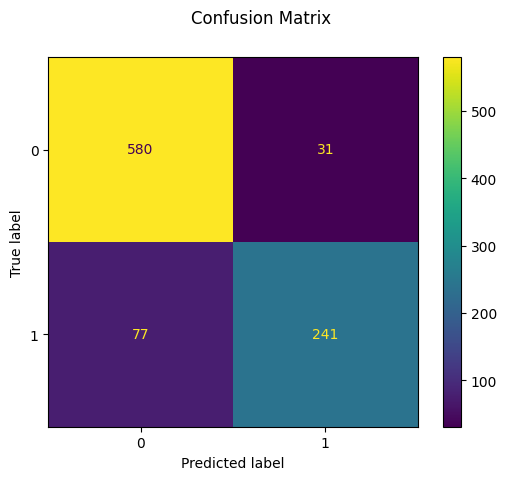

Classification report for classifier DecisionTreeClassifier(class_weight={0: 2.0, 1: 1.0},
                       min_impurity_decrease=0.0001, min_samples_split=20,
                       random_state=0):
              precision    recall  f1-score   support

           0       0.88      0.95      0.91       611
           1       0.89      0.76      0.82       318

    accuracy                           0.88       929
   macro avg       0.88      0.85      0.87       929
weighted avg       0.88      0.88      0.88       929




In [4281]:
# latest, building and landuse

X = nominal_data[nominal_features]
y = nominal_data["is_living"]
weights = {0:2.0, 1:1.0}

# Split data into 80% train and 20% test subsets
X_train, X_test, y_train, y_test = train_test_split(\
    X, y, test_size=0.2, shuffle=True)
# dt_split = DecisionTreeClassifier(class_weight=weights,min_samples_split=20, \
#                                 random_state=0,min_impurity_decrease = 0.0001)

#dt_split = DecisionTreeClassifier(min_samples_split=20, random_state=0,min_impurity_decrease = 0.0001)

# Learn on the train subset
dt_split.fit(X_train, y_train)

# Predict the target on the test subset
predicted = dt_split.predict(X_test)

# 1 = RES; 0 = NON_RES

disp = metrics.ConfusionMatrixDisplay.from_predictions(y_test, predicted)
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.show()

print(
    f"Classification report for classifier {dt_split}:\n"
    f"{metrics.classification_report(y_test, predicted)}\n"
)

In [ ]:
predicted = dt_split.predict(X)

# 1 = RES; 0 = NON_RES

disp = metrics.ConfusionMatrixDisplay.from_predictions(y, predicted)
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.show()

print(
    f"Classification report for classifier {dt_split}:\n"
    f"{metrics.classification_report(y, predicted)}\n"
)

In [4287]:
import pickle

def save_model(model, filename):
    """Сохранение модели в файл"""
    with open(filename, 'wb') as file:
        pickle.dump(model, file)

# Сохраняем модель после первого обучения
save_model(dt_split, '/Users/sashamorozov/Documents/Code/classifier_model_OSM/buildings_classification/model/dt_split.pickle')

In [880]:
def retrain_model(model_path):
    
    with open(model_path, 'rb') as file:
        model = pickle.load(file)
    
    return model

In [881]:
dt_fick = retrain_model('/Users/sashamorozov/Documents/Code/classifier_model_OSM/buildings_classification/model/dt_split.pickle')
dt_fick

DecisionTreeClassifier(class_weight={0: 2.0, 1: 1.0},
                       min_impurity_decrease=0.0001, min_samples_split=20,
                       random_state=0)

Confusion matrix:
[[2708  345]
 [ 582 1010]]


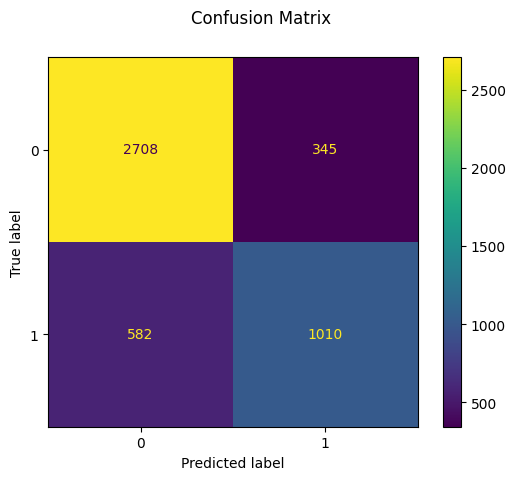

Classification report for classifier DecisionTreeClassifier(class_weight={0: 2.0, 1: 1.0},
                       min_impurity_decrease=0.0001, min_samples_split=20,
                       random_state=0):
              precision    recall  f1-score   support

           0       0.82      0.89      0.85      3053
           1       0.75      0.63      0.69      1592

    accuracy                           0.80      4645
   macro avg       0.78      0.76      0.77      4645
weighted avg       0.80      0.80      0.80      4645




In [4282]:
# result for generating output shape file

X = nominal_data[nominal_features]
y = nominal_data["is_living"]

weights = {0:2.0, 1:1.0}
dt = DecisionTreeClassifier(class_weight=weights,min_samples_split=20, random_state=0,min_impurity_decrease = 0.0001)
y_pred = cross_val_predict(dt, X, y, cv=10)
disp = metrics.ConfusionMatrixDisplay.from_predictions(y, y_pred)
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.show()

print(
    f"Classification report for classifier {dt}:\n"
    f"{metrics.classification_report(y, y_pred)}\n"
)

In [4283]:
output_data = nominal_data.copy()
output_data.drop(columns=['is_living','buffer_cat2_30', 'buffer_cat2_60','buffer_cat2_90'], inplace=True)
output_data.insert(1,'official',y)
output_data.insert(2,'predicted',y_pred)
output_filtered = output_data.copy()
#output_filtered = output_filtered[output_filtered['official'] != output_filtered['predicted']]
output_filtered['official'] = \
    output_filtered['official'].apply(lambda x: 'RES' if x == 1 else 'NON_RES')
output_filtered['predicted'] = \
    output_filtered['predicted'].apply(lambda x: 'RES' if x == 1 else 'NON_RES')

In [4284]:
output_data.explore('predicted')

In [ ]:
import pickle

# 1. Сначала сохраним обученную модель после первичного обучения
def save_model(model, filename):
    """Сохранение модели в файл"""
    with open(filename, 'wb') as file:
        pickle.dump(model, file)

# Сохраняем модель после первого обучения
save_model(dt, 'decision_tree_model.pkl')

# 2. Функция для дообучения модели на новых данных
def retrain_model(model_path, X_new, y_new):
    """
    Дообучение существующей модели на новых данных
    
    Параметры:
    model_path: путь к сохраненной модели
    X_new: новые признаки для обучения
    y_new: новые целевые значения
    """
    # Загружаем существующую модель
    with open(model_path, 'rb') as file:
        model = pickle.load(file)
    
    # Дообучаем модель на новых данных
    model.fit(X_new, y_new)
    
    # Сохраняем обновленную модель
    save_model(model, model_path)
    
    return model

# 3. Пример использования:
# Предположим, у вас есть новые данные X_new, y_new
"""
# Подготовка новых данных аналогично исходным
nominal_data_new = nominal_transform(input_data_new, value_tags)
X_new = nominal_data_new[nominal_features]
y_new = nominal_data_new["is_living"]

# Дообучение модели
updated_model = retrain_model('decision_tree_model.pkl', X_new, y_new)

# Проверка результатов
y_pred_new = updated_model.predict(X_new)
print(metrics.classification_report(y_new, y_pred_new))
"""